# VisDrone: YOLO11 Detection

<div style="text-align: center;">
    <img src="dataset/VisDrone.png" alt="Background" style="width: 70%;"/>
</div>

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [1]:
!nvidia-smi

Tue Dec 10 13:16:46 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.35.03              Driver Version: 560.35.03      CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4080        Off |   00000000:01:00.0  On |                  N/A |
| 30%   24C    P8             10W /  320W |    1044MiB /  16376MiB |     14%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

## Importing Necessary Libraries and Dependencies

In [2]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

import os
import yaml

import numpy as np
import pandas as pd

import ultralytics
from ultralytics import YOLO

import torch
import torchvision
import cv2

from IPython.display import Image as IPyImage
from IPython.display import Video
import shutil

import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

ultralytics.checks()

Ultralytics 8.3.44 🚀 Python-3.10.16 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080, 15966MiB)
Setup complete ✅ (24 CPUs, 30.5 GB RAM, 143.1/1831.7 GB disk)


## YOLO model Information

<div style="text-align: center;">
    <img src="dataset/performance-comparison.png" alt="Background" style="width: 80%;"/>
</div>

In [3]:
# Load a model
model = YOLO("yolo11m.pt")

100%|██████████| 38.8M/38.8M [00:02<00:00, 17.6MB/s]


<div style="text-align: center;">
    <img src="dataset/YOLO models.png" alt="Background" style="width: 60%;"/>
</div>

In [4]:
print(model.model)

DetectionModel(
  (model): Sequential(
    (0): Conv(
      (conv): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(64, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
      (act): SiLU(inplace=True)
    )
    (1): Conv(
      (conv): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(128, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
      (act): SiLU(inplace=True)
    )
    (2): C3k2(
      (cv1): Conv(
        (conv): Conv2d(128, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn): BatchNorm2d(128, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (cv2): Conv(
        (conv): Conv2d(192, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn): BatchNorm2d(256, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
   

## Dataset Preprocessing

The preprocessing of the image annotations is carried out in the notebook **dataset_preprocessing.ipynb**, located in this directory.

In [5]:
# Define the dataset_path
dataset_path = '/home/juangarzon/AI Projects/VisDrone/dataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
  0: pedestrian
  1: people
  2: bicycle
  3: car
  4: van
  5: truck
  6: tricycle
  7: awning-tricycle
  8: bus
  9: motor
path: /home/juangarzon/AI Projects/VisDrone/dataset
test: VisDrone2019-DET-test-dev/images
train: VisDrone2019-DET-train/images
val: VisDrone2019-DET-val/images



This code checks the number of images in the training and validation datasets, verifies if all images have the same size, and prints the results. It tracks unique image sizes for both sets and reports whether they are consistent.

In [6]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'VisDrone2019-DET-train', 'images')
valid_images_path = os.path.join(dataset_path, 'VisDrone2019-DET-val', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):  
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'): 
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 6471
Number of validation images: 548
Training images have varying sizes.
Validation images have varying sizes.


We will now examine a few images from the training dataset to better understand the structure and content of the data.

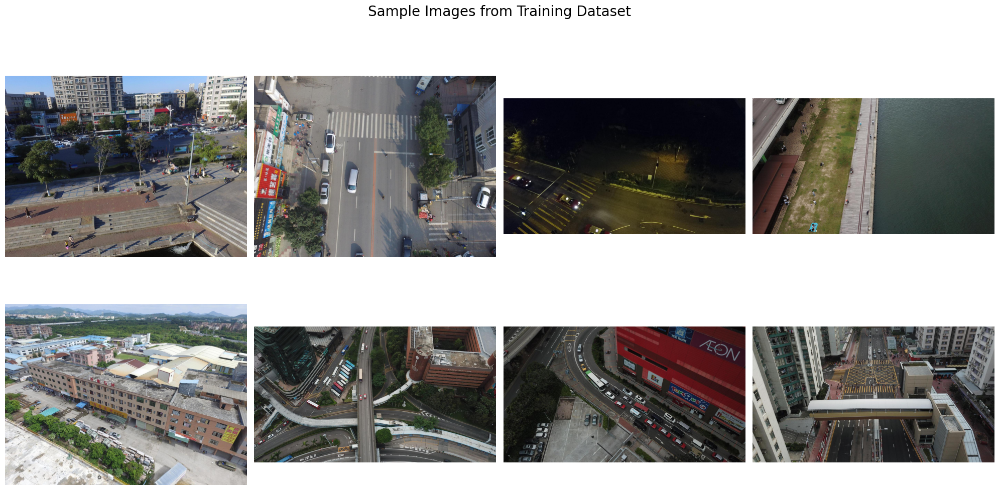

In [7]:
# List all jpg images in the directory
image_files = [file for file in os.listdir(train_images_path) if file.endswith('.jpg')]

# Select 8 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 8)]

# Create a 2x4 subplot
fig, axes = plt.subplots(2, 4, figsize=(20, 11))

# Display each of the selected images
for ax, img_file in zip(axes.ravel(), selected_images):
    img_path = os.path.join(train_images_path, img_file)
    image = Image.open(img_path)
    ax.imshow(image)
    ax.axis('off')  

plt.suptitle('Sample Images from Training Dataset', fontsize=20)
plt.tight_layout()
plt.show()

## Training with custom dataset

After completing the training, the code is commented out to avoid re-training by mistake.

In [ ]:
#results = model.train(
#    data=yaml_file_path,     # Specify the dataset configuration file path
#    epochs=150,              # Set the total number of training iterations
#    imgsz=640,               # Define the input image resolution
#    device=0,                # Choose the computational device (e.g., CUDA device=0)
#    patience=50,             # Stop training if no improvement is seen for this many epochs
#    batch=8,                # Number of samples processed at once
#    optimizer='auto',        # Select the optimization algorithm (options: SGD, Adam, etc.)
#    seed=0                   # Use a fixed seed to ensure consistent results
#)

New https://pypi.org/project/ultralytics/8.3.49 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.44 🚀 Python-3.10.16 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080, 15966MiB)
engine/trainer: task=detect, mode=train, model=yolo11m.pt, data=/home/juangarzon/AI Projects/VisDrone/dataset/data.yaml, epochs=150, time=None, patience=50, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=Fal

100%|██████████| 5.35M/5.35M [00:00<00:00, 5.62MB/s]


AMP: checks passed ✅


train: Scanning /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-train/labels.cache... 6471 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6471/6471 [00:00<?, ?it/s]

train: WARNING ⚠️ /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-train/images/0000137_02220_d_0000163.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-train/images/0000140_00118_d_0000002.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-train/images/9999945_00000_d_0000114.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-train/images/9999987_00000_d_0000049.jpg: 1 duplicate labels removed



val: Scanning /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-val/labels.cache... 548 images, 0 backgrounds, 0 corrupt: 100%|██████████| 548/548 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      5.96G      1.408      1.416     0.9618        505        640: 100%|██████████| 809/809 [01:12<00:00, 11.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 15.16it/s]

                   all        548      38759      0.391      0.307      0.296      0.171



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150       7.4G      1.409      1.125     0.9334        591        640: 100%|██████████| 809/809 [01:06<00:00, 12.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.29it/s]

                   all        548      38759       0.43      0.326      0.319      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      6.18G      1.468       1.14     0.9446        272        640: 100%|██████████| 809/809 [01:07<00:00, 11.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 15.76it/s]

                   all        548      38759      0.419      0.317       0.31      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      6.72G       1.47      1.143     0.9516        459        640: 100%|██████████| 809/809 [01:08<00:00, 11.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 15.66it/s]

                   all        548      38759      0.385      0.317      0.299      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      6.59G      1.434      1.097     0.9441        479        640: 100%|██████████| 809/809 [01:08<00:00, 11.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 15.93it/s]

                   all        548      38759      0.455      0.323       0.33      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150       8.9G      1.407      1.063     0.9366        503        640: 100%|██████████| 809/809 [01:06<00:00, 12.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.13it/s]

                   all        548      38759      0.453      0.334      0.338        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      6.15G      1.385      1.037     0.9318        308        640: 100%|██████████| 809/809 [01:07<00:00, 12.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.37it/s]

                   all        548      38759      0.454      0.337      0.341      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      8.43G      1.362      1.014     0.9267        457        640: 100%|██████████| 809/809 [01:06<00:00, 12.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.72it/s]

                   all        548      38759      0.471      0.342       0.35      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      7.65G      1.345     0.9946     0.9207        434        640: 100%|██████████| 809/809 [01:06<00:00, 12.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.51it/s]

                   all        548      38759      0.468      0.358      0.365      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      7.81G      1.333     0.9747     0.9187        835        640: 100%|██████████| 809/809 [01:06<00:00, 12.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.25it/s]

                   all        548      38759      0.466      0.353      0.358      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      8.54G      1.324     0.9658     0.9187        602        640: 100%|██████████| 809/809 [01:05<00:00, 12.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.87it/s]

                   all        548      38759      0.479      0.364      0.373      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      6.79G      1.311     0.9534     0.9142        599        640: 100%|██████████| 809/809 [01:06<00:00, 12.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.21it/s]

                   all        548      38759      0.495      0.367       0.38      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      7.18G      1.304     0.9389     0.9131        735        640: 100%|██████████| 809/809 [01:07<00:00, 12.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.54it/s]

                   all        548      38759      0.479      0.382      0.382      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      7.73G      1.288     0.9203     0.9081        509        640: 100%|██████████| 809/809 [01:07<00:00, 12.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.46it/s]

                   all        548      38759      0.496      0.386      0.393      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      7.31G      1.285      0.921     0.9088        778        640: 100%|██████████| 809/809 [01:06<00:00, 12.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.61it/s]

                   all        548      38759      0.494       0.38      0.387      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      7.47G      1.269     0.9001     0.9052        621        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.66it/s]

                   all        548      38759       0.52      0.371      0.393      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      8.04G      1.271     0.8988     0.9073        466        640: 100%|██████████| 809/809 [01:06<00:00, 12.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.72it/s]

                   all        548      38759      0.493      0.383      0.398      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      8.08G      1.265     0.8852     0.9036        677        640: 100%|██████████| 809/809 [01:06<00:00, 12.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.79it/s]

                   all        548      38759      0.512      0.384      0.402      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      6.69G      1.251     0.8806     0.9003        919        640: 100%|██████████| 809/809 [01:06<00:00, 12.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.63it/s]

                   all        548      38759      0.509      0.395      0.405      0.246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      6.47G      1.239     0.8673     0.9002        758        640: 100%|██████████| 809/809 [01:06<00:00, 12.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.89it/s]

                   all        548      38759      0.526      0.391      0.407      0.246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150       7.4G      1.246     0.8695     0.8998        570        640: 100%|██████████| 809/809 [01:06<00:00, 12.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.85it/s]

                   all        548      38759      0.512      0.402      0.412      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      7.67G      1.237     0.8557     0.8998        623        640: 100%|██████████| 809/809 [01:06<00:00, 12.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.41it/s]

                   all        548      38759      0.516      0.393      0.408      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      8.02G       1.23     0.8514      0.895        383        640: 100%|██████████| 809/809 [01:06<00:00, 12.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.54it/s]

                   all        548      38759      0.527      0.401      0.419      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      6.46G      1.218     0.8417     0.8948        445        640: 100%|██████████| 809/809 [01:08<00:00, 11.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.40it/s]

                   all        548      38759      0.533      0.398      0.419      0.254



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      6.98G      1.219     0.8399     0.8945        325        640: 100%|██████████| 809/809 [01:07<00:00, 11.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.92it/s]

                   all        548      38759      0.532      0.402       0.42      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      6.94G      1.216     0.8352     0.8958        729        640: 100%|██████████| 809/809 [01:07<00:00, 12.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.73it/s]

                   all        548      38759      0.537      0.406      0.424      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      7.86G      1.211      0.828     0.8922        864        640: 100%|██████████| 809/809 [01:07<00:00, 11.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.38it/s]

                   all        548      38759      0.543      0.398      0.422      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      7.45G       1.21      0.823     0.8917        526        640: 100%|██████████| 809/809 [01:08<00:00, 11.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.48it/s]

                   all        548      38759      0.525      0.411      0.424      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      8.51G      1.207     0.8222     0.8905        512        640: 100%|██████████| 809/809 [01:08<00:00, 11.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.49it/s]

                   all        548      38759      0.532      0.411      0.427      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      6.26G      1.199      0.814     0.8897        603        640: 100%|██████████| 809/809 [01:08<00:00, 11.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.37it/s]

                   all        548      38759      0.539      0.415      0.431      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      6.67G        1.2      0.809     0.8903        407        640: 100%|██████████| 809/809 [01:08<00:00, 11.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.76it/s]

                   all        548      38759      0.553      0.409      0.432      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      8.65G      1.197     0.8067     0.8872        439        640: 100%|██████████| 809/809 [01:07<00:00, 12.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.49it/s]

                   all        548      38759      0.529       0.41      0.428      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150       6.7G      1.188     0.8008     0.8873        489        640: 100%|██████████| 809/809 [01:07<00:00, 12.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.05it/s]

                   all        548      38759      0.544      0.412      0.429      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      7.66G      1.194     0.8001     0.8872        676        640: 100%|██████████| 809/809 [01:06<00:00, 12.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.01it/s]

                   all        548      38759      0.545      0.419      0.437      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      7.91G      1.183     0.7907     0.8859        677        640: 100%|██████████| 809/809 [01:06<00:00, 12.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.97it/s]

                   all        548      38759      0.553      0.412      0.436      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      7.31G       1.18     0.7885     0.8855        601        640: 100%|██████████| 809/809 [01:06<00:00, 12.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.98it/s]

                   all        548      38759      0.539      0.419      0.438      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      6.66G      1.178      0.786     0.8847        658        640: 100%|██████████| 809/809 [01:06<00:00, 12.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.91it/s]

                   all        548      38759      0.539      0.422      0.439      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      8.04G      1.172     0.7777     0.8839        470        640: 100%|██████████| 809/809 [01:08<00:00, 11.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.59it/s]

                   all        548      38759      0.554      0.431      0.447      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150       8.7G      1.168     0.7764     0.8841        600        640: 100%|██████████| 809/809 [01:07<00:00, 11.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.97it/s]

                   all        548      38759      0.558      0.418      0.442       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      8.25G      1.161     0.7697      0.883        908        640: 100%|██████████| 809/809 [01:06<00:00, 12.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.07it/s]

                   all        548      38759      0.557       0.42      0.444      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      7.52G      1.168     0.7668     0.8807        599        640: 100%|██████████| 809/809 [01:06<00:00, 12.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.95it/s]

                   all        548      38759      0.546      0.429      0.445      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      7.04G      1.161     0.7642      0.881        562        640: 100%|██████████| 809/809 [01:06<00:00, 12.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.05it/s]

                   all        548      38759      0.555      0.426      0.444      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      7.99G      1.154     0.7599     0.8803        379        640: 100%|██████████| 809/809 [01:06<00:00, 12.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.10it/s]

                   all        548      38759      0.557      0.419      0.444      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      8.18G      1.155       0.76     0.8786        526        640: 100%|██████████| 809/809 [01:06<00:00, 12.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.04it/s]

                   all        548      38759      0.556      0.421      0.444      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      7.19G      1.156      0.754     0.8806        686        640: 100%|██████████| 809/809 [01:06<00:00, 12.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.58it/s]

                   all        548      38759       0.56      0.426      0.447      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      8.42G      1.153     0.7508      0.877        440        640: 100%|██████████| 809/809 [01:06<00:00, 12.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.14it/s]

                   all        548      38759      0.537      0.434      0.449      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      8.44G      1.158     0.7479     0.8792        649        640: 100%|██████████| 809/809 [01:06<00:00, 12.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.10it/s]

                   all        548      38759       0.55      0.422      0.446      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      7.65G      1.157     0.7505     0.8789        620        640: 100%|██████████| 809/809 [01:06<00:00, 12.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.57it/s]

                   all        548      38759      0.555      0.428      0.448      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      6.89G      1.148      0.744     0.8767        676        640: 100%|██████████| 809/809 [01:07<00:00, 11.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.23it/s]

                   all        548      38759      0.565      0.421      0.446      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      9.47G      1.142     0.7376     0.8772        402        640: 100%|██████████| 809/809 [01:06<00:00, 12.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.13it/s]

                   all        548      38759      0.567      0.423      0.452       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      8.41G      1.135     0.7302      0.875        606        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.79it/s]

                   all        548      38759      0.576      0.428      0.454       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150       9.4G      1.133     0.7267     0.8736        683        640: 100%|██████████| 809/809 [01:06<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.11it/s]

                   all        548      38759      0.568      0.428      0.451      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      6.15G      1.136     0.7257     0.8746        379        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.24it/s]

                   all        548      38759      0.565      0.425      0.452      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      6.94G      1.135     0.7261      0.875        670        640: 100%|██████████| 809/809 [01:06<00:00, 12.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.00it/s]

                   all        548      38759      0.564      0.425      0.451      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      6.87G      1.125      0.721     0.8732        529        640: 100%|██████████| 809/809 [01:06<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.16it/s]

                   all        548      38759      0.568      0.433      0.456      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      6.05G      1.123     0.7179     0.8724        560        640: 100%|██████████| 809/809 [01:06<00:00, 12.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.96it/s]

                   all        548      38759      0.554      0.439      0.457      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      6.32G      1.132     0.7211     0.8742        866        640: 100%|██████████| 809/809 [01:06<00:00, 12.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.19it/s]

                   all        548      38759      0.561      0.438      0.456      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      8.07G      1.123     0.7143     0.8727        544        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.11it/s]

                   all        548      38759      0.562      0.435      0.453      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      8.01G       1.12     0.7104      0.872        423        640: 100%|██████████| 809/809 [01:06<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.89it/s]

                   all        548      38759      0.565      0.432      0.457      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      7.12G      1.117     0.7059      0.872        620        640: 100%|██████████| 809/809 [01:06<00:00, 12.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.27it/s]

                   all        548      38759      0.574      0.428      0.455       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      9.38G      1.115     0.7018     0.8699        610        640: 100%|██████████| 809/809 [01:06<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.97it/s]

                   all        548      38759      0.566      0.435      0.457      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150       6.9G      1.116     0.7017     0.8709        536        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.31it/s]

                   all        548      38759      0.565      0.435      0.456      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      7.55G      1.114     0.6971     0.8694        586        640: 100%|██████████| 809/809 [01:06<00:00, 12.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.25it/s]

                   all        548      38759      0.564      0.438      0.457      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      7.83G      1.109     0.6946     0.8709        640        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.17it/s]

                   all        548      38759      0.549      0.438      0.455      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      7.03G      1.111     0.6927     0.8695       1010        640: 100%|██████████| 809/809 [01:06<00:00, 12.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.15it/s]

                   all        548      38759      0.566      0.435      0.457      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      7.59G      1.104      0.686     0.8682        374        640: 100%|██████████| 809/809 [01:06<00:00, 12.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.32it/s]

                   all        548      38759      0.551      0.439      0.458      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      7.74G      1.108     0.6897     0.8693        765        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.26it/s]

                   all        548      38759      0.565      0.433      0.457      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150       7.2G      1.101     0.6855     0.8669        499        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.22it/s]

                   all        548      38759      0.571      0.433      0.455      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      6.89G      1.096     0.6806     0.8673        586        640: 100%|██████████| 809/809 [01:06<00:00, 12.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.29it/s]

                   all        548      38759      0.572      0.435      0.461      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      7.68G      1.102       0.68     0.8683        587        640: 100%|██████████| 809/809 [01:06<00:00, 12.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.17it/s]

                   all        548      38759      0.577      0.432      0.457      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      7.47G      1.095     0.6737     0.8675        657        640: 100%|██████████| 809/809 [01:06<00:00, 12.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.10it/s]

                   all        548      38759       0.57      0.436      0.456      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      6.77G      1.096     0.6766     0.8653        460        640: 100%|██████████| 809/809 [01:06<00:00, 12.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.06it/s]

                   all        548      38759      0.577      0.432      0.458      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150       7.8G      1.085     0.6675     0.8651        437        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.41it/s]

                   all        548      38759      0.573      0.438      0.459      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150       7.8G       1.09     0.6659     0.8651        505        640: 100%|██████████| 809/809 [01:06<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.40it/s]

                   all        548      38759      0.579      0.435      0.458      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      8.03G      1.092     0.6688     0.8648        638        640: 100%|██████████| 809/809 [01:07<00:00, 12.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.96it/s]

                   all        548      38759      0.572      0.438       0.46      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      7.93G      1.087     0.6609      0.863        442        640: 100%|██████████| 809/809 [01:06<00:00, 12.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.16it/s]

                   all        548      38759      0.568      0.439      0.458      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      6.66G      1.085     0.6592     0.8641        495        640: 100%|██████████| 809/809 [01:06<00:00, 12.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.39it/s]

                   all        548      38759      0.562      0.439      0.455      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      9.44G       1.08     0.6567     0.8629        412        640: 100%|██████████| 809/809 [01:06<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.40it/s]

                   all        548      38759      0.584       0.43       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      6.82G       1.08     0.6543     0.8624        607        640: 100%|██████████| 809/809 [01:06<00:00, 12.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.28it/s]

                   all        548      38759      0.572      0.439      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      6.68G      1.082     0.6553     0.8625        803        640: 100%|██████████| 809/809 [01:06<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.92it/s]

                   all        548      38759      0.579      0.435      0.458      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      7.86G      1.069     0.6476     0.8624        657        640: 100%|██████████| 809/809 [01:06<00:00, 12.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.46it/s]

                   all        548      38759      0.582      0.433      0.459      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      8.83G      1.073     0.6454     0.8607        433        640: 100%|██████████| 809/809 [01:06<00:00, 12.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.38it/s]

                   all        548      38759      0.572      0.438      0.461      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      6.88G      1.072     0.6459     0.8605        437        640: 100%|██████████| 809/809 [01:07<00:00, 12.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.21it/s]

                   all        548      38759      0.568      0.437      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150       7.6G      1.069     0.6423     0.8612        449        640: 100%|██████████| 809/809 [01:06<00:00, 12.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.35it/s]

                   all        548      38759      0.578      0.436      0.461      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      7.72G      1.066      0.639     0.8605        798        640: 100%|██████████| 809/809 [01:06<00:00, 12.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.10it/s]

                   all        548      38759      0.567      0.441      0.461      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      7.24G       1.07     0.6407     0.8608        503        640: 100%|██████████| 809/809 [01:08<00:00, 11.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.96it/s]

                   all        548      38759      0.583       0.43       0.46      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      7.67G      1.068      0.637     0.8601        576        640: 100%|██████████| 809/809 [01:08<00:00, 11.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.07it/s]

                   all        548      38759      0.577      0.437      0.461      0.285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150      8.13G      1.061     0.6327     0.8598        523        640: 100%|██████████| 809/809 [01:07<00:00, 11.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.32it/s]

                   all        548      38759      0.575      0.439      0.463      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      8.08G      1.061     0.6303     0.8591        348        640: 100%|██████████| 809/809 [01:06<00:00, 12.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.28it/s]

                   all        548      38759      0.571      0.439      0.461      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      8.08G      1.056     0.6304     0.8595        525        640: 100%|██████████| 809/809 [01:07<00:00, 12.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.07it/s]

                   all        548      38759      0.585      0.431      0.461      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      8.44G      1.056     0.6274      0.858        533        640: 100%|██████████| 809/809 [01:06<00:00, 12.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.31it/s]

                   all        548      38759       0.59      0.427       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      6.96G      1.056     0.6244     0.8579        453        640: 100%|██████████| 809/809 [01:06<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.52it/s]

                   all        548      38759      0.567      0.439      0.459      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      8.36G      1.055     0.6212     0.8573        528        640: 100%|██████████| 809/809 [01:05<00:00, 12.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.68it/s]

                   all        548      38759      0.573      0.435      0.458      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      6.18G      1.049     0.6157     0.8561        410        640: 100%|██████████| 809/809 [01:06<00:00, 12.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.37it/s]

                   all        548      38759      0.566      0.439      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      7.04G      1.046     0.6164     0.8566        568        640: 100%|██████████| 809/809 [01:05<00:00, 12.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.67it/s]

                   all        548      38759      0.578      0.435      0.462      0.285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      7.28G      1.046     0.6137     0.8561        724        640: 100%|██████████| 809/809 [01:05<00:00, 12.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.41it/s]

                   all        548      38759      0.571       0.44      0.463      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150      7.04G      1.049     0.6129     0.8559        622        640: 100%|██████████| 809/809 [01:05<00:00, 12.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.73it/s]

                   all        548      38759      0.577      0.438      0.463      0.285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      6.72G      1.035     0.6068     0.8551        559        640: 100%|██████████| 809/809 [01:05<00:00, 12.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.68it/s]

                   all        548      38759      0.585      0.433      0.462      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      7.96G      1.039     0.6052     0.8543        643        640: 100%|██████████| 809/809 [01:05<00:00, 12.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.74it/s]

                   all        548      38759      0.579      0.438      0.461      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      6.87G      1.038     0.6028     0.8539        503        640: 100%|██████████| 809/809 [01:05<00:00, 12.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.60it/s]

                   all        548      38759      0.583      0.439      0.461      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      8.11G      1.036     0.6029     0.8529        506        640: 100%|██████████| 809/809 [01:05<00:00, 12.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.75it/s]

                   all        548      38759      0.586      0.437      0.462      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      7.35G      1.037     0.6017     0.8542        480        640: 100%|██████████| 809/809 [01:05<00:00, 12.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.66it/s]

                   all        548      38759      0.584      0.433       0.46      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      6.85G      1.034     0.5999     0.8542        114        640: 100%|██████████| 809/809 [01:05<00:00, 12.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.74it/s]

                   all        548      38759       0.58      0.438       0.46      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150       7.8G      1.031      0.596     0.8536        513        640: 100%|██████████| 809/809 [01:05<00:00, 12.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.80it/s]

                   all        548      38759      0.572      0.441       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      7.13G      1.022     0.5906     0.8505        524        640: 100%|██████████| 809/809 [01:05<00:00, 12.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.82it/s]

                   all        548      38759      0.576      0.437       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      7.77G      1.028     0.5924     0.8509        519        640: 100%|██████████| 809/809 [01:05<00:00, 12.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.70it/s]

                   all        548      38759      0.582      0.431      0.458      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150       6.8G      1.024     0.5897     0.8519        258        640: 100%|██████████| 809/809 [01:05<00:00, 12.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.82it/s]

                   all        548      38759      0.576      0.433      0.458      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      6.47G      1.019      0.586     0.8498        796        640: 100%|██████████| 809/809 [01:05<00:00, 12.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.84it/s]

                   all        548      38759      0.578      0.433      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      7.35G      1.019     0.5848     0.8501        506        640: 100%|██████████| 809/809 [01:05<00:00, 12.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.73it/s]

                   all        548      38759      0.569       0.44       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      6.89G       1.02      0.584     0.8504        617        640: 100%|██████████| 809/809 [01:05<00:00, 12.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.83it/s]

                   all        548      38759      0.583      0.432       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150         8G      1.009     0.5772     0.8491        601        640: 100%|██████████| 809/809 [01:06<00:00, 12.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.09it/s]

                   all        548      38759      0.582      0.436       0.46      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      5.83G      1.011     0.5787     0.8496        399        640: 100%|██████████| 809/809 [01:07<00:00, 11.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.11it/s]

                   all        548      38759      0.574      0.441       0.46      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      7.81G      1.003      0.573      0.849        425        640: 100%|██████████| 809/809 [01:05<00:00, 12.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.75it/s]

                   all        548      38759      0.585      0.432      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      7.13G      1.007     0.5758      0.848        635        640: 100%|██████████| 809/809 [01:06<00:00, 12.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.81it/s]

                   all        548      38759      0.583      0.436      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      6.56G      1.004     0.5717     0.8484        306        640: 100%|██████████| 809/809 [01:06<00:00, 12.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.49it/s]

                   all        548      38759      0.581      0.436       0.46      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      8.91G      1.002     0.5706     0.8482        559        640: 100%|██████████| 809/809 [01:05<00:00, 12.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.72it/s]

                   all        548      38759      0.574      0.438      0.458      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      7.05G      1.002     0.5668     0.8467       1151        640: 100%|██████████| 809/809 [01:07<00:00, 11.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.16it/s]

                   all        548      38759      0.572       0.44      0.459      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      6.41G      1.003     0.5687     0.8475        430        640: 100%|██████████| 809/809 [01:07<00:00, 12.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.83it/s]

                   all        548      38759      0.573       0.44      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      8.69G      1.003     0.5663     0.8475        462        640: 100%|██████████| 809/809 [01:07<00:00, 11.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.20it/s]

                   all        548      38759      0.575      0.441       0.46      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      6.31G     0.9933     0.5591      0.847        660        640: 100%|██████████| 809/809 [01:06<00:00, 12.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.74it/s]

                   all        548      38759      0.576       0.44       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      7.17G      1.001     0.5635      0.846        886        640: 100%|██████████| 809/809 [01:07<00:00, 11.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.08it/s]

                   all        548      38759      0.571      0.441       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      6.83G     0.9921     0.5568     0.8442        774        640: 100%|██████████| 809/809 [01:08<00:00, 11.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.02it/s]

                   all        548      38759       0.57      0.441       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      6.72G     0.9898      0.556     0.8451        325        640: 100%|██████████| 809/809 [01:08<00:00, 11.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.18it/s]

                   all        548      38759      0.572      0.439      0.459      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      7.07G     0.9857     0.5539     0.8449       1001        640: 100%|██████████| 809/809 [01:08<00:00, 11.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.31it/s]

                   all        548      38759      0.571       0.44       0.46      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      9.33G     0.9857     0.5521     0.8444        316        640: 100%|██████████| 809/809 [01:08<00:00, 11.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.34it/s]

                   all        548      38759      0.566      0.441      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      8.09G     0.9819     0.5488     0.8445        470        640: 100%|██████████| 809/809 [01:07<00:00, 11.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.26it/s]

                   all        548      38759      0.567       0.44      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      7.66G     0.9788     0.5464     0.8438        385        640: 100%|██████████| 809/809 [01:08<00:00, 11.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.34it/s]

                   all        548      38759      0.566       0.44      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      9.85G     0.9792     0.5453     0.8427        401        640: 100%|██████████| 809/809 [01:08<00:00, 11.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.31it/s]

                   all        548      38759      0.563      0.443      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      8.05G     0.9757     0.5433     0.8431        411        640: 100%|██████████| 809/809 [01:08<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.40it/s]

                   all        548      38759      0.572      0.438      0.459      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      7.73G     0.9727      0.541     0.8421        659        640: 100%|██████████| 809/809 [01:07<00:00, 11.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.35it/s]

                   all        548      38759      0.579      0.435      0.458      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      7.65G     0.9722     0.5411     0.8434        524        640: 100%|██████████| 809/809 [01:08<00:00, 11.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.33it/s]

                   all        548      38759      0.572      0.436      0.458      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      8.47G     0.9746     0.5408     0.8418        332        640: 100%|██████████| 809/809 [01:08<00:00, 11.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.40it/s]

                   all        548      38759      0.573      0.435      0.457      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      7.65G      0.969     0.5368     0.8413        315        640: 100%|██████████| 809/809 [01:08<00:00, 11.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.18it/s]

                   all        548      38759      0.568      0.437      0.457      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150       7.6G     0.9713     0.5367     0.8412        646        640: 100%|██████████| 809/809 [01:08<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.24it/s]

                   all        548      38759      0.566      0.439      0.457      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150       7.8G     0.9645     0.5332     0.8415        847        640: 100%|██████████| 809/809 [01:07<00:00, 11.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.88it/s]

                   all        548      38759      0.567      0.437      0.456      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150       7.2G     0.9628     0.5297      0.841        604        640: 100%|██████████| 809/809 [01:09<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 16.93it/s]

                   all        548      38759      0.567      0.436      0.456      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      7.77G     0.9645     0.5297     0.8402        511        640: 100%|██████████| 809/809 [01:08<00:00, 11.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.70it/s]

                   all        548      38759      0.571      0.434      0.456      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      9.09G     0.9599     0.5264     0.8398        342        640: 100%|██████████| 809/809 [01:06<00:00, 12.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:02<00:00, 17.22it/s]

                   all        548      38759      0.571      0.434      0.455      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      7.44G     0.9534     0.5244     0.8399        305        640: 100%|██████████| 809/809 [01:07<00:00, 12.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:01<00:00, 17.67it/s]

                   all        548      38759      0.569      0.434      0.455      0.281
EarlyStopping: Training stopped early as no improvement observed in last 50 epochs. Best results observed at epoch 89, best model saved as best.pt.
To update EarlyStopping(patience=50) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



139 epochs completed in 2.681 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 40.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.44 🚀 Python-3.10.16 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080, 15966MiB)
YOLO11m summary (fused): 303 layers, 20,037,742 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:05<00:00,  6.61it/s]


                   all        548      38759      0.572      0.439      0.462      0.286
            pedestrian        520       8844      0.636       0.45      0.513      0.248
                people        482       5125      0.635       0.31      0.382      0.157
               bicycle        364       1287      0.344      0.232       0.21      0.097
                   car        515      14064      0.798      0.791       0.83       0.61
                   van        421       1975      0.573      0.498      0.493      0.359
                 truck        266        750      0.591      0.437      0.454      0.314
              tricycle        337       1045       0.47      0.383      0.366      0.214
       awning-tricycle        220        532       0.35      0.195        0.2      0.127
                   bus        131        251      0.757      0.586      0.654      0.489
                 motor        485       4886      0.563      0.508      0.514      0.245
Speed: 0.1ms preproce

## GPU Monitoring

Here is the image showing the monitoring of a machine learning training process on the Nvidia GeForce RTX 4080 GPU. It displays the terminal logs with GPU usage, memory consumption, and training progress.

<div style="text-align: center;">
    <img src="dataset/GPU monitoring.png" alt="Background" style="width: 60%;"/>
</div>

## Model Evaluation

In [9]:
# Define the path to the directory
training_files_path = 'runs/detect/train'

### Confusion Matrix

In [10]:
print(model.names)

{0: 'pedestrian', 1: 'people', 2: 'bicycle', 3: 'car', 4: 'van', 5: 'truck', 6: 'tricycle', 7: 'awning-tricycle', 8: 'bus', 9: 'motor'}


This code loads and displays a confusion matrix image, converting it from BGR to RGB color space for proper color representation with Matplotlib.

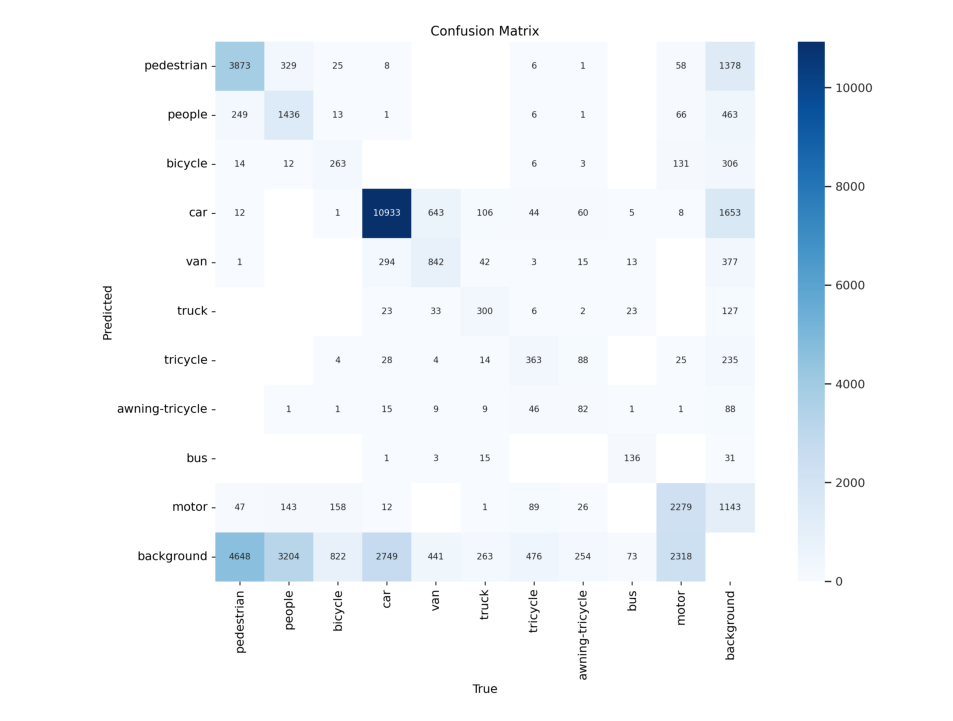

In [25]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(training_files_path, 'confusion_matrix.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off') 
plt.show()

### Train and Validation Loss

This code defines a function that plots learning curves for loss values over epochs for both training and validation. It uses seaborn to plot the training and validation loss with custom colors and line styles.

In [12]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='#141140', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orangered', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

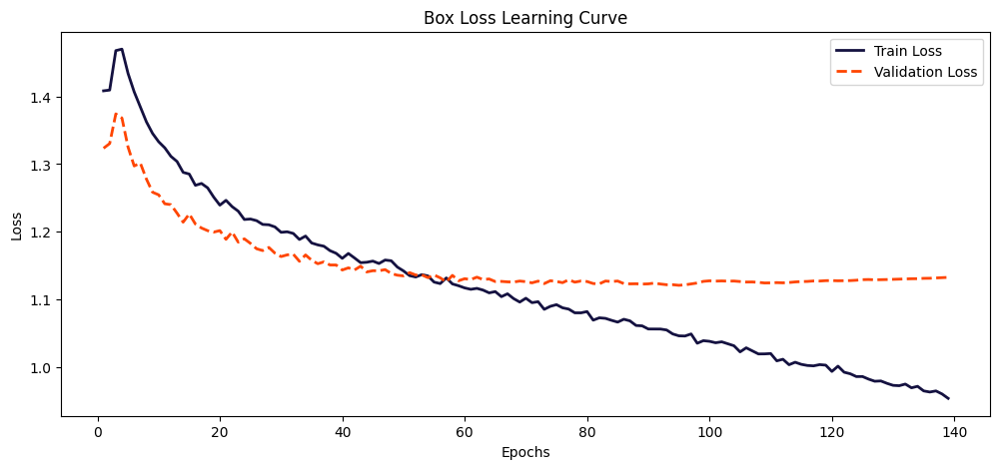

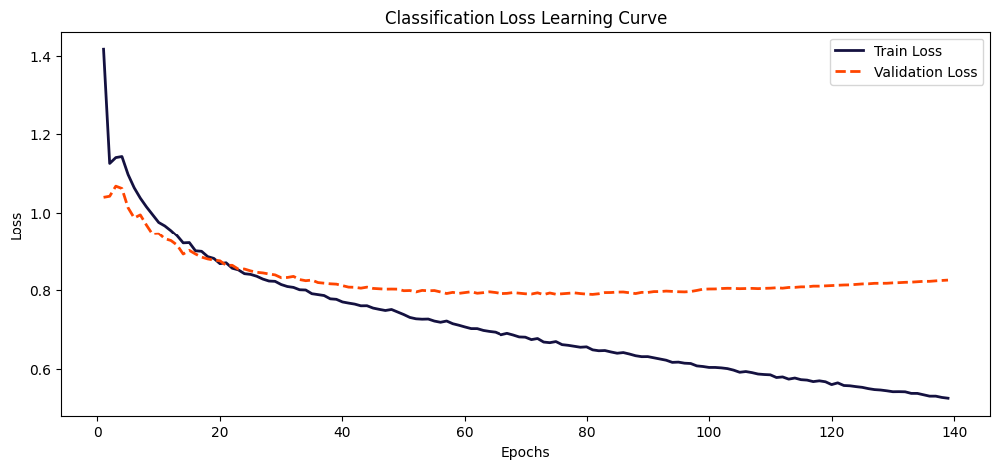

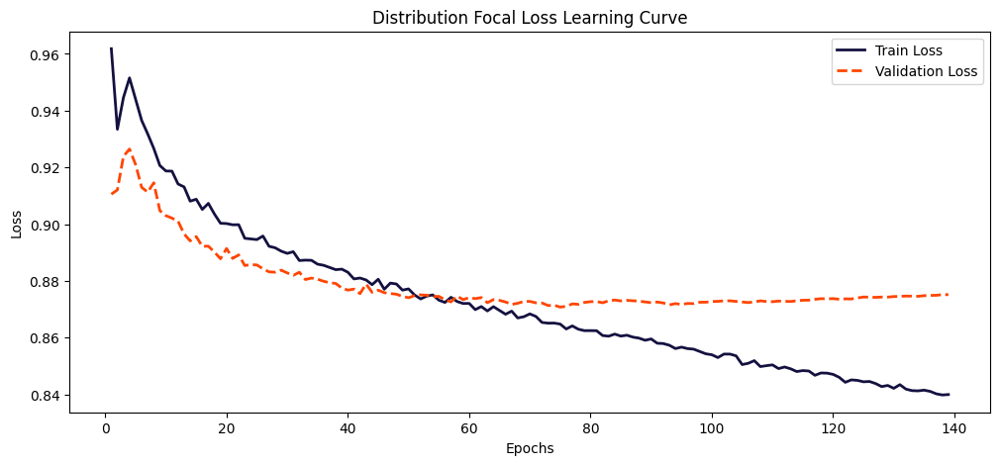

In [13]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

## Inference on Validation Set Images

In [16]:
# Construct the path to the best model weights file using os.path.join
model_path = os.path.join(training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics 8.3.44 🚀 Python-3.10.16 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4080, 15966MiB)
YOLO11m summary (fused): 303 layers, 20,037,742 parameters, 0 gradients, 67.7 GFLOPs


val: Scanning /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-val/labels.cache... 548 images, 0 backgrounds, 0 corrupt: 100%|██████████| 548/548 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 35/35 [00:06<00:00,  5.57it/s]


                   all        548      38759      0.571       0.44      0.462      0.287
            pedestrian        520       8844      0.637      0.453      0.514      0.251
                people        482       5125      0.637      0.314      0.384      0.158
               bicycle        364       1287      0.342      0.235      0.211     0.0986
                   car        515      14064      0.795      0.792      0.829      0.612
                   van        421       1975      0.572      0.499      0.494       0.36
                 truck        266        750      0.582      0.434      0.451      0.315
              tricycle        337       1045       0.47      0.385      0.366      0.215
       awning-tricycle        220        532      0.351      0.197      0.199      0.127
                   bus        131        251      0.759      0.586      0.655       0.49
                 motor        485       4886      0.561      0.508      0.514      0.247
Speed: 0.2ms preproce


image 1/1 /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-val/images/0000316_01201_d_0000525.jpg: 384x640 8 pedestrians, 1 people, 14 cars, 2 vans, 1 truck, 2 tricycles, 1 motor, 34.1ms
Speed: 1.2ms preprocess, 34.1ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-val/images/0000348_03333_d_0000423.jpg: 384x640 8 pedestrians, 3 peoples, 1 bicycle, 2 tricycles, 1 motor, 4.4ms
Speed: 1.2ms preprocess, 4.4ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-val/images/0000193_00000_d_0000103.jpg: 384x640 2 pedestrians, 4 peoples, 8 cars, 1 van, 1 truck, 4 tricycles, 11 motors, 4.8ms
Speed: 1.7ms preprocess, 4.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /home/juangarzon/AI Projects/VisDrone/dataset/VisDrone2019-DET-val/images/0000312_01201_d_0000420.jpg: 384x64

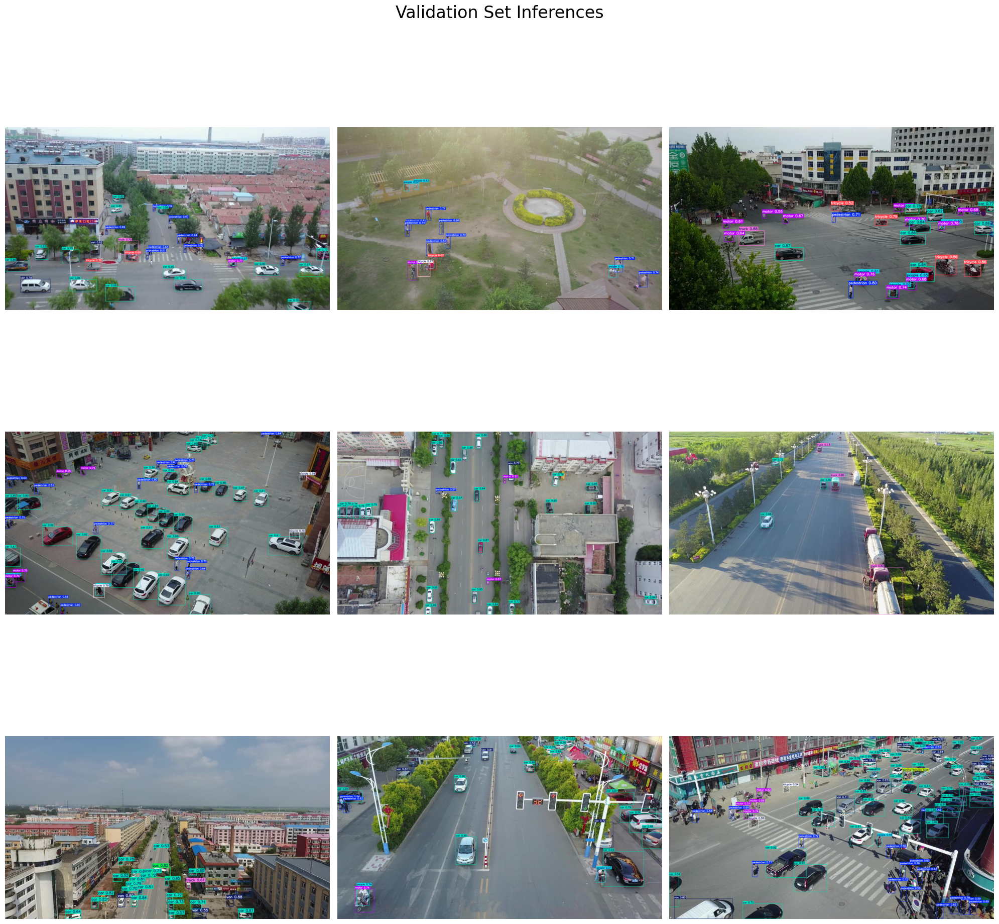

In [17]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, 'VisDrone2019-DET-val', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Validation Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(valid_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()

## Test custom model

### Prediction on an Unseen Test Image


image 1/1 /home/juangarzon/AI Projects/VisDrone/dataset/image_test2.jpg: 448x640 34 cars, 1 van, 2 trucks, 38.5ms
Speed: 14.9ms preprocess, 38.5ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


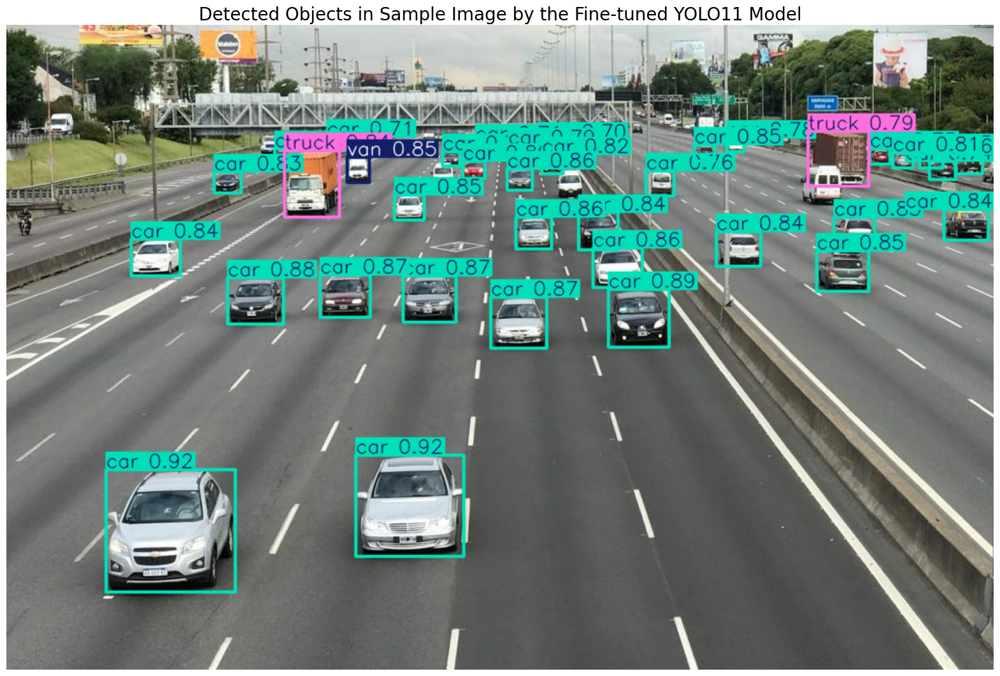

In [21]:
# Path to the image file
sample_image_path = 'dataset/image_test2.jpg'

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640, conf=0.7) 
                        
# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLO11 Model', fontsize=20)
plt.axis('off')
plt.show()

### Prediction on an Unseen Test Video

In [19]:
# Define the destination path in the working directory
video_path = 'dataset/video_test_people.mp4'

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source=video_path, save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/341) /home/juangarzon/AI Projects/VisDrone/dataset/video_test_people.mp4: 384x640 40 pedestrians, 4.7ms
video 1/1 (frame 2/341) /home/juangarzon/AI Projects/VisDrone/dataset/video_test_people.mp4: 384x640 43 pedestrians, 4.5ms
video 1/1 (frame 3/341) /home/juangarzon/AI Projects/VisDrone/dataset/video_test_people.mp4: 384x640 45 pedestrians, 4.4ms
video 1/1 (frame 4/341) /home/juangarzon/AI Projects/VisDrone/dataset/video_test_people

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'pedestrian', 1: 'people', 2: 'bicycle', 3: 'car', 4: 'van', 5: 'truck', 6: 'tricycle', 7: 'awning-tricycle', 8: 'bus', 9: 'motor'}
 obb: None
 orig_img: array([[[128, 128, 128],
         [128, 128, 128],
         [128, 128, 128],
         ...,
         [148, 151, 149],
         [148, 151, 149],
         [149, 152, 150]],
 
        [[128, 128, 128],
         [128, 128, 128],
         [128, 128, 128],
         ...,
         [148, 151, 149],
         [148, 151, 149],
         [149, 152, 150]],
 
        [[128, 128, 128],
         [128, 128, 128],
         [128, 128, 128],
         ...,
         [148, 151, 149],
         [148, 151, 149],
         [149, 152, 150]],
 
        ...,
 
        [[199, 202, 200],
         [199, 202, 200],
         [199, 202, 200],
         ...,
         [229, 229, 229],
         [229, 229, 229],
         [229, 22

In [ ]:
# Convert the .avi video generated by the YOLO11 prediction to .mp4 format for compatibility with notebook display
!ffmpeg -y -loglevel panic -i /home/juangarzon/AI\ Projects/VisDrone/runs/detect/predict/video_test_people.avi video_demo.mp4

# Embed and display the processed sample video within the notebook
Video("video_demo.mp4", embed=True, width=960)

## Dataset Citation

This code reads a BibTeX file and prints the details of each reference, including the title, authors, journal, and publication year. 

In [ ]:
from pybtex.database import parse_file

bib_data = parse_file("citation.bib", bib_format="bibtex")

for key, entry in bib_data.entries.items():
    title = entry.fields.get('title', 'Untitled')
    year = entry.fields.get('year', 'No year')
    journal = entry.fields.get('journal', 'No journal')
    authors = ', '.join(' '.join(person.last_names) for person in entry.persons.get('author', []))
    
    print(f"Reference: {key}")
    print(f"  Title: {title}")
    print(f"  Authors: {authors}")
    print(f"  Published in: {journal} ({year})\n")

Reference: zhu2021detection
  Title: Detection and tracking meet drones challenge
  Authors: Zhu, Wen, Du, Bian, Fan, Hu, Ling
  Published in: IEEE Transactions on Pattern Analysis and Machine Intelligence (2021)

